In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy



In [5]:
df = pd.read_csv('./input_data/bank-additional/bank-additional-full.csv',sep=';')

In [6]:
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             41188 non-null  object 
 2   marital         41188 non-null  object 
 3   education       41188 non-null  object 
 4   default         41188 non-null  object 
 5   housing         41188 non-null  object 
 6   loan            41188 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp.var.rate    41188 non-null  float64
 16  cons.price.idx  41188 non-null  float64
 17  cons.conf.idx   41188 non-null 

### Phần 1

In [8]:
from dataprep.datasets import load_dataset
from dataprep.eda import create_report, plot

In [9]:
report = create_report(df)

  0%|                                                                                         | 0/2863 [00:00<…

C:\Program Files\Python39\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
C:\Program Files\Python39\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))


DataPrep Report
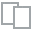
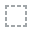
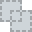
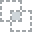
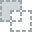
...
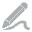
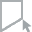
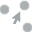
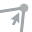
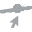

In [10]:
report

### Phần 2

In [11]:
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


### 1. Xác định thuộc tính

* 1.1 Input: <> y (tern deposit)
    * 1.2 Outout: y
* 1.3 Type of variable:
    *    1.3.1 Predictor: <> y
    *    1.3.2 Targer: y
* 1.4 Data type:
    *    1.4.1 Charactor/string
    *    1.4.2 Numeric
* 1.5 Variable Category


In [13]:
numbers = [f for f in df.columns if df.dtypes[f]!='object']

In [14]:
numbers

['age',
 'duration',
 'campaign',
 'pdays',
 'previous',
 'emp.var.rate',
 'cons.price.idx',
 'cons.conf.idx',
 'euribor3m',
 'nr.employed']

In [19]:
objects = [f for f in df.columns if df.dtypes[f]=='object']

In [20]:
objects

['job',
 'marital',
 'education',
 'default',
 'housing',
 'loan',
 'contact',
 'month',
 'day_of_week',
 'poutcome',
 'y']

* 1.5 Variable Category
    * 1.5.1 Categorical: Kiểu số, chuỗi
    * 1.5.2 Continuous: int, float

In [23]:
# Categorial
# Xem xét các biến phân loại kiểu chuổi
i=1
for obj in objects:
    print(i, '/', obj, '\t', len(df[obj].unique()),':', df[obj].unique())
    i=i+1

1 / job 	 12 : ['housemaid' 'services' 'admin.' 'blue-collar' 'technician' 'retired'
 'management' 'unemployed' 'self-employed' 'unknown' 'entrepreneur'
 'student']
2 / marital 	 4 : ['married' 'single' 'divorced' 'unknown']
3 / education 	 8 : ['basic.4y' 'high.school' 'basic.6y' 'basic.9y' 'professional.course'
 'unknown' 'university.degree' 'illiterate']
4 / default 	 3 : ['no' 'unknown' 'yes']
5 / housing 	 3 : ['no' 'yes' 'unknown']
6 / loan 	 3 : ['no' 'yes' 'unknown']
7 / contact 	 2 : ['telephone' 'cellular']
8 / month 	 10 : ['may' 'jun' 'jul' 'aug' 'oct' 'nov' 'dec' 'mar' 'apr' 'sep']
9 / day_of_week 	 5 : ['mon' 'tue' 'wed' 'thu' 'fri']
10 / poutcome 	 3 : ['nonexistent' 'failure' 'success']
11 / y 	 2 : ['no' 'yes']


In [27]:
# Categorial
# Xem xét các biến phân loại kiểu số
i=1
for obj in numbers:
    print(i, '/', obj, '\t', len(df[obj].unique()),':',
          df[obj].unique() if len(df[obj].unique())<50 else '')
    i=i+1

1 / age 	 78 : 
2 / duration 	 1544 : 
3 / campaign 	 42 : [ 1  2  3  4  5  6  7  8  9 10 11 12 13 19 18 23 14 22 25 16 17 15 20 56
 39 35 42 28 26 27 32 21 24 29 31 30 41 37 40 33 34 43]
4 / pdays 	 27 : [999   6   4   3   5   1   0  10   7   8   9  11   2  12  13  14  15  16
  21  17  18  22  25  26  19  27  20]
5 / previous 	 8 : [0 1 2 3 4 5 6 7]
6 / emp.var.rate 	 10 : [ 1.1  1.4 -0.1 -0.2 -1.8 -2.9 -3.4 -3.  -1.7 -1.1]
7 / cons.price.idx 	 26 : [93.994 94.465 93.918 93.444 93.798 93.2   92.756 92.843 93.075 92.893
 92.963 92.469 92.201 92.379 92.431 92.649 92.713 93.369 93.749 93.876
 94.055 94.215 94.027 94.199 94.601 94.767]
8 / cons.conf.idx 	 26 : [-36.4 -41.8 -42.7 -36.1 -40.4 -42.  -45.9 -50.  -47.1 -46.2 -40.8 -33.6
 -31.4 -29.8 -26.9 -30.1 -33.  -34.8 -34.6 -40.  -39.8 -40.3 -38.3 -37.5
 -49.5 -50.8]
9 / euribor3m 	 316 : 
10 / nr.employed 	 11 : [5191.  5228.1 5195.8 5176.3 5099.1 5076.2 5017.5 5023.5 5008.7 4991.6
 4963.6]


### 2. Phân tích đơn biến

In [28]:
%matplotlib inline

In [29]:
df.columns

Index(['age', 'job', 'marital', 'education', 'default', 'housing', 'loan',
       'contact', 'month', 'day_of_week', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome', 'emp.var.rate', 'cons.price.idx',
       'cons.conf.idx', 'euribor3m', 'nr.employed', 'y'],
      dtype='object')

#### Continuous vatiable

In [31]:
def uniariate_analysis_continuous_variable(df, feature):
    print('Describe: ')
    print(feature.describe(include='all'))
    print('Mode: ', feature.mode())
    print('Range: ', feature.values.ptp())
    print('IQR: ', scipy.stats.iqr(feature))
    print('Var: ', feature.var())
    print('Std: ', feature.std())
    print('Skew: ', feature.skew())
    print('Kurtosis: ', feature.kurtosis())
    

In [32]:
def check_outlier(df, feature):
    plt.boxplot(feature)
    plt.show()
    Q1= np.percentile(feature, 25)
    Q3= np.percentile(feature, 75)
    n_O_upper = df[feature > (Q3 + 1.5*scipy.stats.iqr(feature))].shape[0]
    print('Number of upper outlier:', n_O_upper)
    n_O_lower = df[feature < (Q1 - 1.5*scipy.stats.iqr(feature))].shape[0]
    print('Number of lower outlier:', n_O_lower)
    # Percentage of outliers
    outlier_per = (n_O_lower + n_O_upper)/df.shape[0]
    print('Percentage of outliers:', outlier_per)
    return Q1, Q3, n_O_upper, n_O_lower, outlier_per
    

In [33]:
def uniariate_visualization_analysis_continuous_variable(feature):
    # historgram
    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1)
    sns.histplot(feature, kde=True, stat='density')
    plt.subplot(1,2,2)
    plt.hist(feature)
    plt.show()
    
    #boxplot
    plt.figure(figsize=(4,5))
    plt.boxplot(feature)
    plt.show()


In [34]:
uniariate_analysis_continuous_variable(df,df['age'])

Describe: 
count    41188.00000
mean        40.02406
std         10.42125
min         17.00000
25%         32.00000
50%         38.00000
75%         47.00000
max         98.00000
Name: age, dtype: float64
Mode:  0    31
Name: age, dtype: int64
Range:  81
IQR:  15.0
Var:  108.60245116511788
Std:  10.421249980934048
Skew:  0.7846968157646645
Kurtosis:  0.7913115311544336


In [35]:
# skew > 0 : Phân phối lệch phải
# kur > 0: phân phối nhọn hơn pp chuẩn

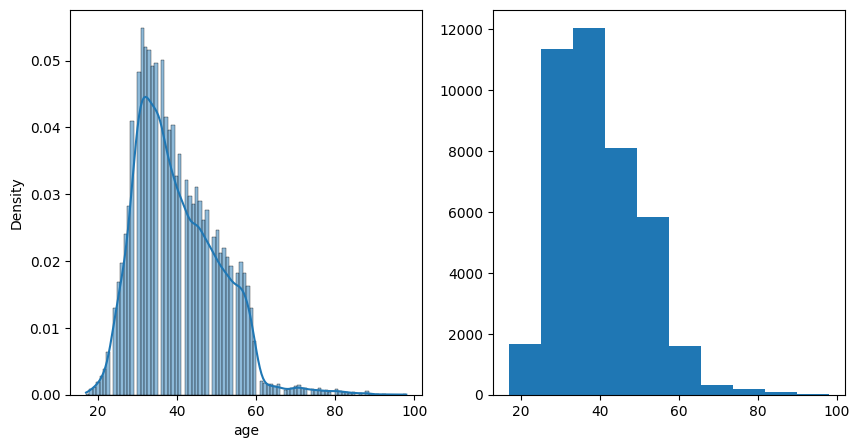

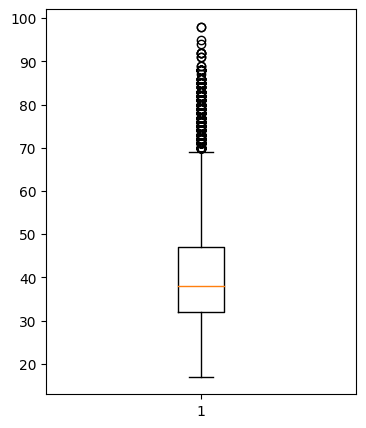

In [36]:
uniariate_visualization_analysis_continuous_variable(df['age'])

In [37]:
# Có outlier trên 68 tuổi

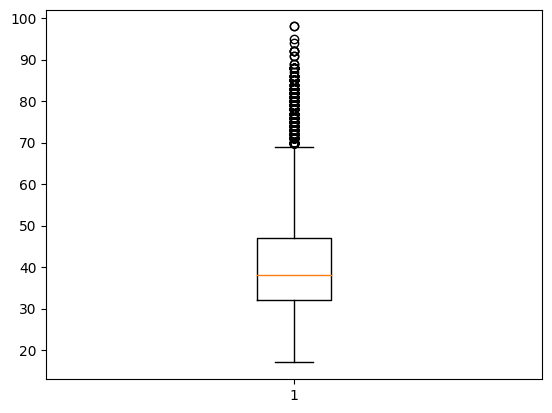

Number of upper outlier: 469
Number of lower outlier: 0
Percentage of outliers: 0.011386811692726036


In [38]:
Q1_age, Q3_age, n_O_upper_age, n_O_lower_age, \
outlier_per_age = check_outlier(df,df['age'])

In [39]:
outlier_per_age*100

1.1386811692726035

In [40]:
# 1.13% dữ liệu có outlier
# loại bỏ outlier

### Categorical variable

In [51]:
def uniariate_analysis_continuous_variable_2(df, feature):
    pass
    

In [52]:
uniariate_analysis_continuous_variable_2(df,'job')

### 3. Phân tích 2 biến

* Continuous & Continuous
* Categorical & Categorical
* Categorical & continuous

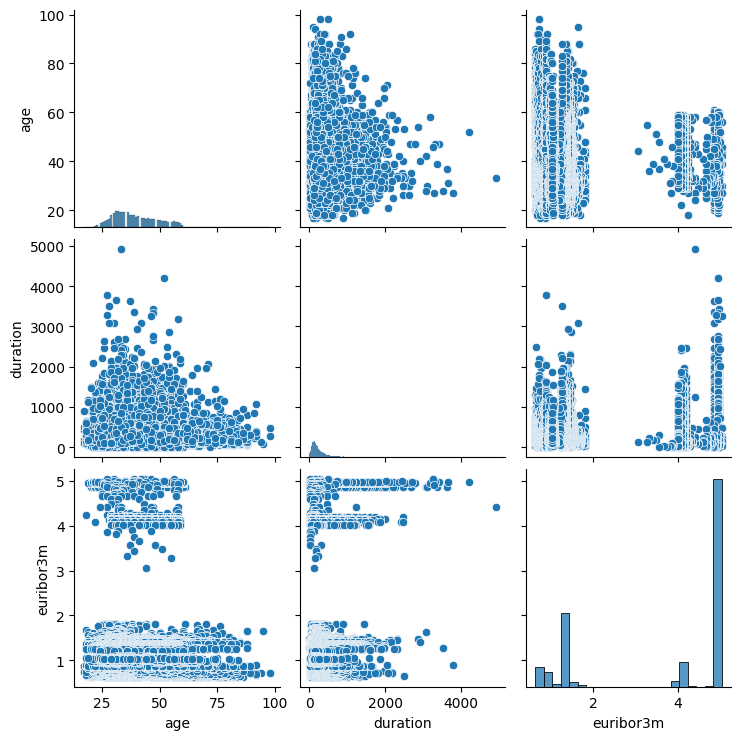

In [56]:
# Continuous & Continuous
sns.pairplot(df[['age','duration','euribor3m']])
plt.show()

In [57]:
df[['age','duration','euribor3m']].corr()

,age,duration,euribor3m
age,1.000000,-0.000866,0.010767
duration,-0.000866,1.000000,-0.032897
euribor3m,0.010767,-0.032897,1.000000


In [58]:
# => 3 biến trên không có quan hệ tuyến tính

In [59]:
df.corr()

C:\Users\phamp\AppData\Local\Temp\ipykernel_26520\1134722465.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
age,1.000000,-0.000866,0.004594,-0.034369,0.024365,-0.000371,0.000857,0.129372,0.010767,-0.017725
duration,-0.000866,1.000000,-0.071699,-0.047577,0.020640,-0.027968,0.005312,-0.008173,-0.032897,-0.044703
campaign,0.004594,-0.071699,1.000000,0.052584,-0.079141,0.150754,0.127836,-0.013733,0.135133,0.144095
pdays,-0.034369,-0.047577,0.052584,1.000000,-0.587514,0.271004,0.078889,-0.091342,0.296899,0.372605
previous,0.024365,0.020640,-0.079141,-0.587514,1.000000,-0.420489,-0.203130,-0.050936,-0.454494,-0.501333
emp.var.rate,-0.000371,-0.027968,0.150754,0.271004,-0.420489,1.000000,0.775334,0.196041,0.972245,0.906970
cons.price.idx,0.000857,0.005312,0.127836,0.078889,-0.203130,0.775334,1.000000,0.058986,0.688230,0.522034
cons.conf.idx,0.129372,-0.008173,-0.013733,-0.091342,-0.050936,0.196041,0.058986,1.000000,0.277686,0.100513
euribor3m,0.010767,-0.032897,0.135133,0.296899,-0.454494,0.972245,0.688230,0.277686,1.000000,0.945154
nr.employed,-0.017725,-0.044703,0.144095,0.372605,-0.501333,0.906970,0.522034,0.100513,0.945154,1.000000


In [ ]:
# Categorical & Categorical

In [60]:
# Categorical & continuous

In [61]:
df_sub = df[['education','emp.var.rate']]
df_sub.head()

,education,emp.var.rate
0,basic.4y,1.1
1,high.school,1.1
2,high.school,1.1
3,basic.6y,1.1
4,high.school,1.1


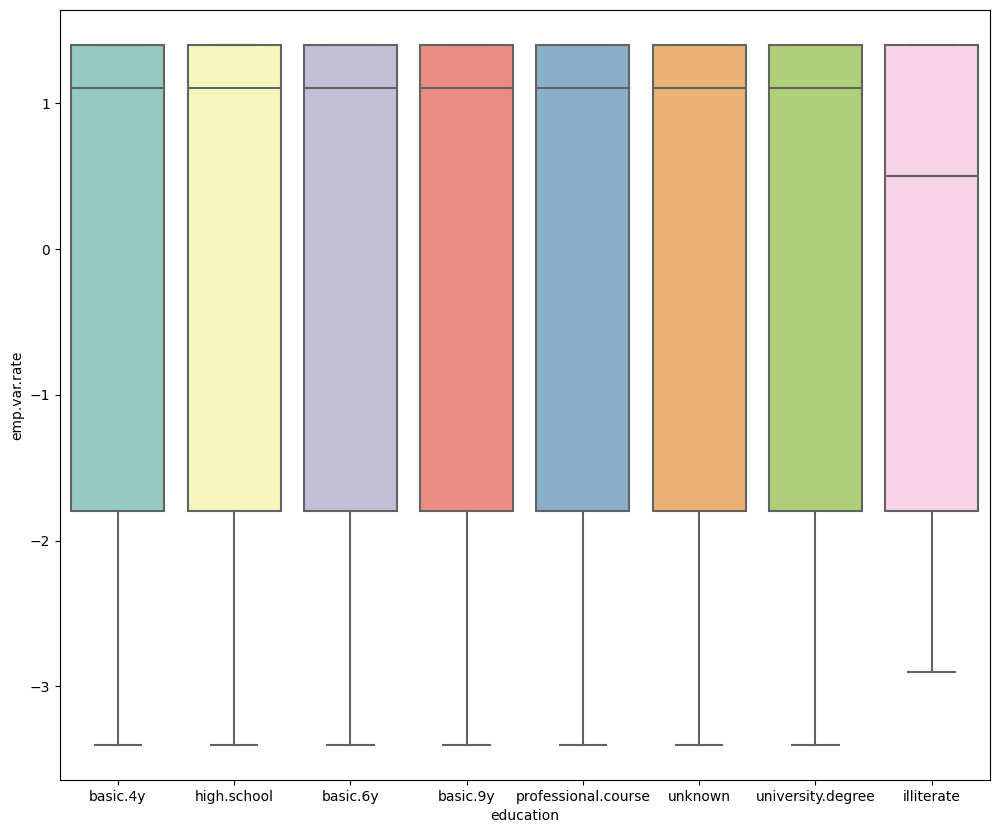

In [62]:
plt.figure(figsize=(12,10))
sns.boxplot(x='education', y ='emp.var.rate',
           data=df_sub, palette='Set3')
plt.show()

In [64]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [66]:
df_sub.columns=['education','emp_var_rate']

In [68]:
model = ols('emp_var_rate ~ C(education)', data=df_sub).fit()
anova_table = sm.stats.anova_lm(model, typ =2)
anova_table

,sum_sq,df,F,PR(>F)
C(education),377.499930,7.0,21.929606,8.505778e-30
Residual,101268.494842,41180.0,NaN,NaN


* p_value thua được từ phân tích anova cho education và emp.var.rate phối hợp có ý nghĩa thống kê
* Kết luận: education ảnh hưởng đáng kể đến emp.var.rate

In [70]:
from statsmodels.stats.multicomp import pairwise_tukeyhsd
m_comp = pairwise_tukeyhsd(endog=df_sub['emp_var_rate'],
                          groups=df_sub['education'],
                          alpha=0.05)
print(m_comp)

             Multiple Comparison of Means - Tukey HSD, FWER=0.05              
       group1              group2       meandiff p-adj   lower   upper  reject
------------------------------------------------------------------------------
           basic.4y            basic.6y   0.0152    1.0 -0.1083  0.1388  False
           basic.4y            basic.9y  -0.0567 0.6226 -0.1523   0.039  False
           basic.4y         high.school   -0.183    0.0 -0.2712 -0.0948   True
           basic.4y          illiterate  -0.3493 0.9818  -1.472  0.7735  False
           basic.4y professional.course  -0.0429 0.8918 -0.1415  0.0557  False
           basic.4y   university.degree   -0.244    0.0 -0.3293 -0.1588   True
           basic.4y             unknown  -0.1568 0.0111 -0.2927  -0.021   True
           basic.6y            basic.9y  -0.0719 0.5721 -0.1885  0.0447  False
           basic.6y         high.school  -0.1982    0.0 -0.3088 -0.0876   True
           basic.6y          illiterate  -0.3645  0.

* Các kết quả trên từ turkey HSH cho thấy 1 số cặp (False): chấp nhận H0, các so sánh cặp khác bác bỏ H0 và chỉ ra sự khác biệt đáng kể về mặt thống kê

### 4. Xử lý dữ liệu trùng thiếu

In [71]:
df.isna().sum()

age               0
job               0
marital           0
education         0
default           0
housing           0
loan              0
contact           0
month             0
day_of_week       0
duration          0
campaign          0
pdays             0
previous          0
poutcome          0
emp.var.rate      0
cons.price.idx    0
cons.conf.idx     0
euribor3m         0
nr.employed       0
y                 0
dtype: int64

In [72]:
# Không có dữ liệu NaN

In [73]:
df.duplicated().sum()

12

In [75]:
# Trước khi xóa dữ liệu trùng
df.shape

(41188, 21)

In [77]:
# Sau khi xóa dữ liệu trùng
df= df.drop_duplicates()
df.shapepe

(41176, 21)

### 5. Phát hiện và xử lý ngoại lệ

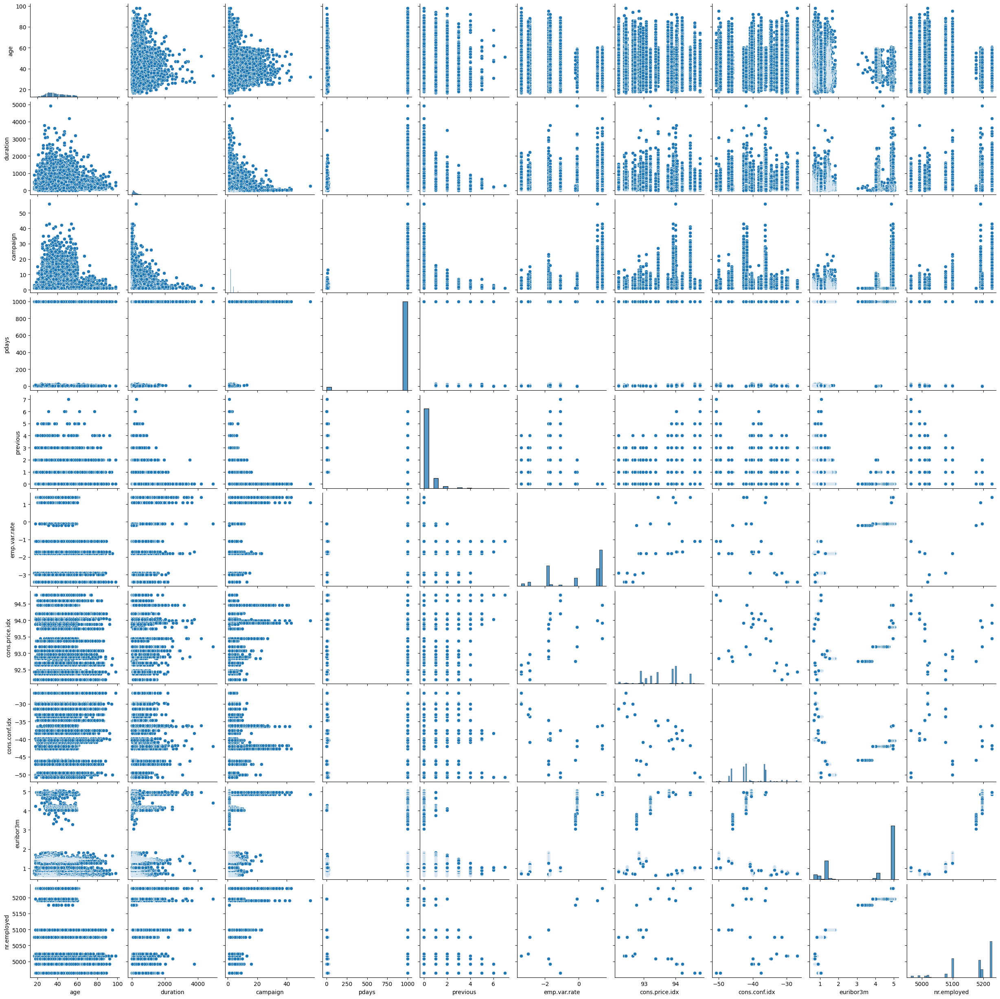

In [79]:
sns.pairplot(df)

In [ ]:
# Tiếp tục xem xét biến age

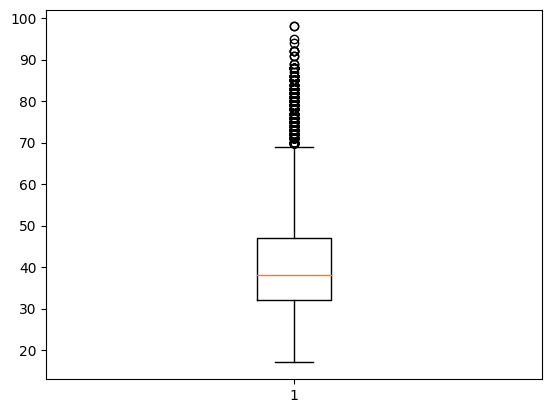

Number of upper outlier: 468
Number of lower outlier: 0
Percentage of outliers: 0.011365844181076355


In [80]:
Q1_age, Q3_age, n_O_upper_age, n_O_lower_age, \
outlier_per_age = check_outlier(df,df['age'])

In [81]:
# Có thể drop outlier của age: tổng số outlier là 1% dử liệu

In [82]:
df.shape

(41176, 21)

In [83]:
df_now = df[(df.age < Q3_age + 1.5*(Q3_age-Q1_age))]

In [84]:
df_now.shape

(40708, 21)

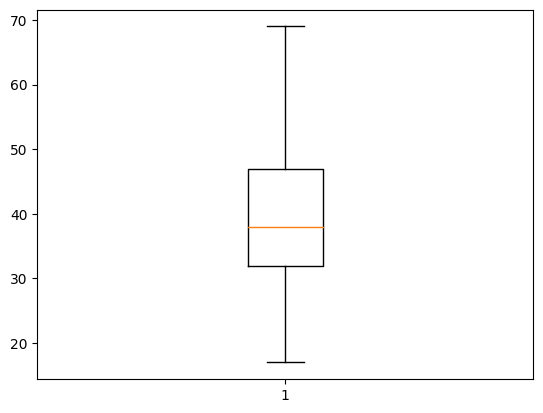

In [86]:
plt.boxplot(df_now.age)
plt.show()

In [87]:
# Dữ liệu không còn outlier

In [88]:
df_now.age.mean()

39.599390783138446

In [89]:
df.age.mean()

40.02380027200311

In [90]:
# Không nhất thiết phải loại bỏ ngoại lệ vì chênh lệch so với mean nhỏ

## Phần 3

In [93]:
# tạo cột conversion dựa trên y, 'yes' => 1, 'no'=> 0

In [94]:
df['conversion']= df['y'].apply(lambda x:1 if x=='yes' else 0)

In [96]:
print('Total conversion: %i out of %i' %(df.conversion.sum(),df.shape[0]))

Total conversion: 4639 out of 41176


In [98]:
print('Conversion rate: %0.2f%%' %(df.conversion.sum()/df.shape[0]*100))

Conversion rate: 11.27%


In [99]:
# Tính toán conversion rate theo từng age

In [101]:
conversion_by_age = df.groupby(by='age')['conversion'].sum() /df.groupby(by='age')['conversion'].count()*100

In [102]:
conversion_by_age

age
17     40.000000
18     42.857143
19     47.619048
20     35.384615
21     28.431373
         ...    
91      0.000000
92     75.000000
94      0.000000
95      0.000000
98    100.000000
Name: conversion, Length: 78, dtype: float64

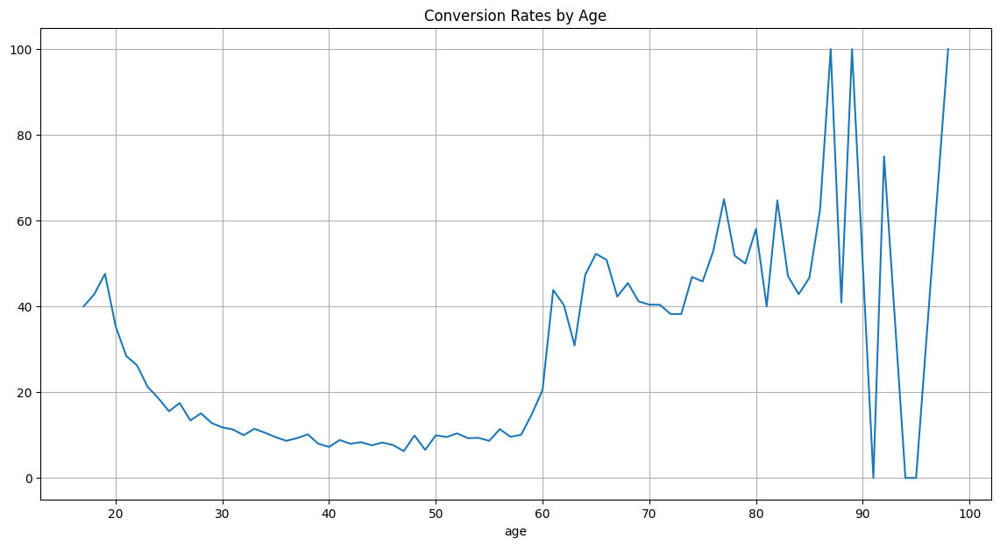

In [103]:
conversion_by_age.plot(grid=True, figsize=(14,7), title='Conversion Rates by Age')
plt.show()

In [104]:
df['age_group']=df['age'].apply(lambda x: '[18,30)' \
                               if x < 30 else '[30,40)' if x < 40 \
                               else '[40,50)' if x < 50 else '[50,60)' if x< 60 \
                               else '[60,70)' if x <70 else '70+')

In [106]:
conversions_by_age_group = df.groupby(by='age_group')['conversion'].sum()/df.groupby(by='age_group')['conversion'].count()*100

In [107]:
conversions_by_age_group

age_group
70+        47.222222
[18,30)    16.269631
[30,40)    10.128152
[40,50)     7.915994
[50,60)    10.158869
[60,70)    34.668508
Name: conversion, dtype: float64

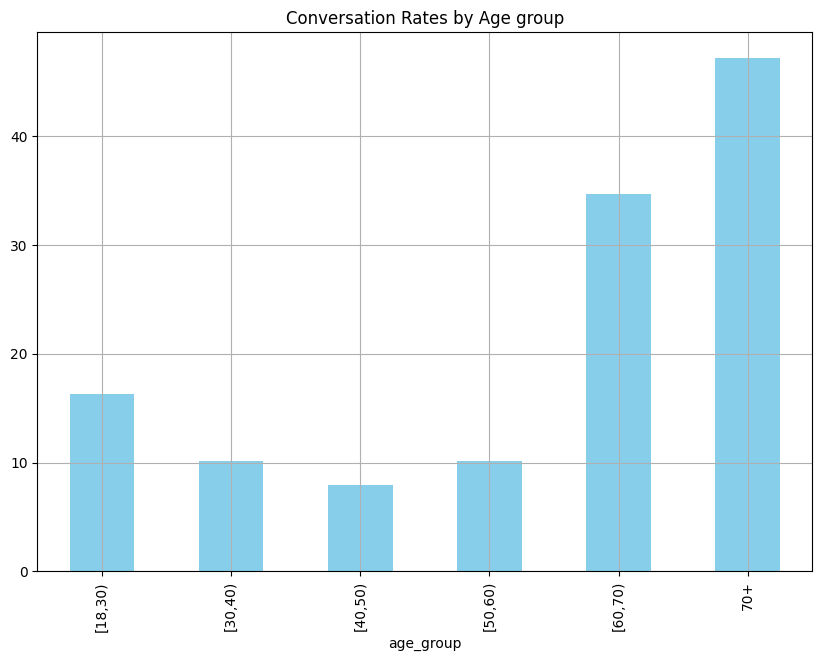

In [108]:
conversions_by_age_group.loc[
['[18,30)','[30,40)','[40,50)','[50,60)','[60,70)','70+']
].plot(kind='bar', color='skyblue', grid = True, figsize=(10,7),
      title = 'Conversation Rates by Age group')
plt.show()

In [109]:
df.groupby(['marital','y'])['conversion'].count()

marital   y  
divorced  no      4135
          yes      476
married   no     22390
          yes     2531
single    no      9944
          yes     1620
unknown   no        68
          yes       12
Name: conversion, dtype: int64

In [110]:
conversion_by_marital_status_df = pd.pivot_table(df, values='y',
                                                index='marital',
                                                columns='conversion',
                                                aggfunc=len)
conversion_by_marital_status_df

conversion,0,1
marital,,
divorced,4135,476
married,22390,2531
single,9944,1620
unknown,68,12


In [111]:
conversion_by_marital_status_df.columns=['non_conversion','conversion']

In [112]:
conversion_by_marital_status_df

,non_conversion,conversion
marital,,
divorced,4135,476
married,22390,2531
single,9944,1620
unknown,68,12


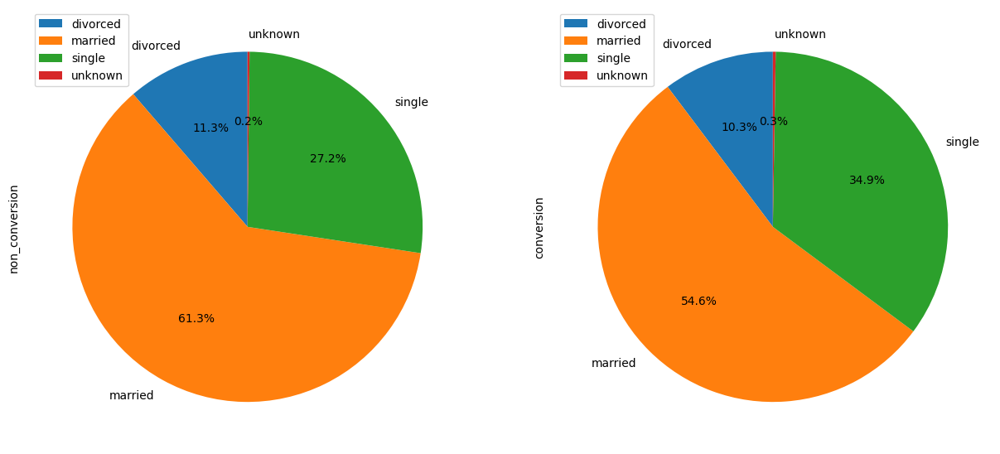

In [115]:
conversion_by_marital_status_df.plot(kind='pie',
                                    figsize=(15,7),
                                    startangle=90,
                                    subplots = True,
                                    autopct = lambda x: '%0.1f%%' % x)
plt.show()

In [116]:
age_marital_df = df.groupby(['age_group','marital'])['conversion'].sum().unstack('marital').fillna(0)


In [117]:
age_marital_df = age_marital_df.divide(
df.groupby(
    by='age_group'
)['conversion'].count(),axis=0
)

In [118]:
age_marital_df

marital,divorced,married,single,unknown
age_group,,,,
70+,0.136752,0.322650,0.012821,0.000000
"[18,30)",0.002118,0.027881,0.132522,0.000176
"[30,40)",0.007559,0.052973,0.040394,0.000354
"[40,50)",0.011974,0.054547,0.012354,0.000285
"[50,60)",0.017344,0.077685,0.006413,0.000146
"[60,70)",0.037293,0.301105,0.006906,0.001381


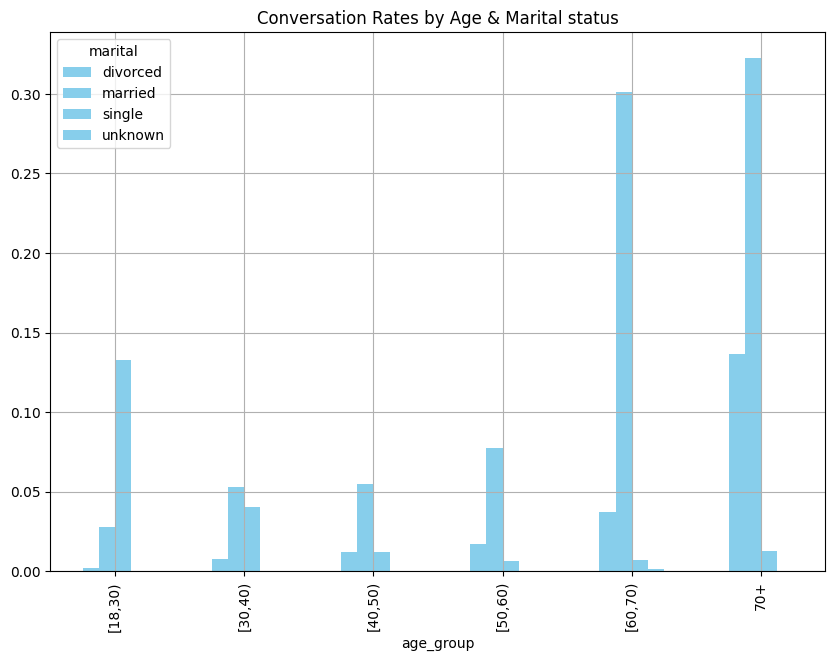

In [120]:
ax = age_marital_df.loc[
    ['[18,30)','[30,40)','[40,50)','[50,60)','[60,70)','70+']
].plot(kind='bar', color='skyblue', grid = True, figsize=(10,7),
      title = 'Conversation Rates by Age & Marital status')
plt.show()


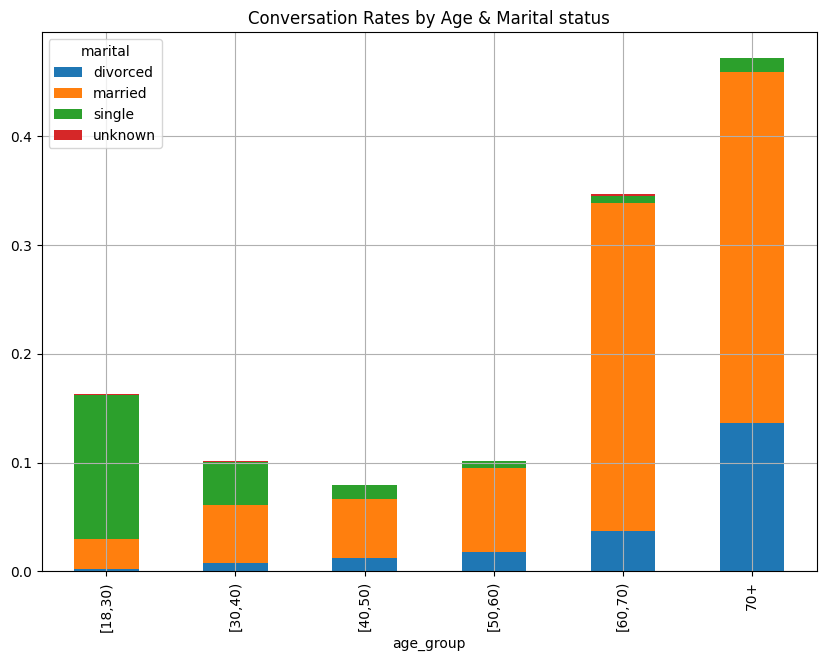

In [122]:
ax = age_marital_df.loc[
    ['[18,30)','[30,40)','[40,50)','[50,60)','[60,70)','70+']
].plot(kind='bar', stacked = True, grid = True, figsize=(10,7),
      title = 'Conversation Rates by Age & Marital status')
plt.show()
